In [2]:
import os
import sys
import pickle
import numpy as np
from collections import defaultdict
from PIL import Image

sys.path.append("../../utils/")
import geospatial_utils as GSUtil

# GeoLife
sys.path.append("../../Datasets/GeolifeTrajectories1.3/")
import geolife_data as GLData

import torch
from torchvision import transforms
from torchvision import utils
from torchvision.transforms import functional 

# Plotting
import matplotlib.pyplot as plt
%load_ext autoreload
%autoreload 2

Loading BokehJS ...

In [3]:
gmaps_api_key = None
# dataset
GEOLIFE_DIR = "../../Datasets/GeolifeTrajectories1.3/"
IMAGE_FEATURE_DIR = "./features/satellite_rgb/"

In [3]:
def phi_gmaps_satellite(location, store_dir=IMAGE_FEATURE_DIR, 
                        img_size="128x128", zoom=19, mode="RGB", 
                        gmaps_api_key=gmaps_api_key, verbose=True):
    
    img = GLData.feature(location, 
                         img_size=img_size,
                         zoom=zoom, 
                         mode=mode,
                         api_key=gmaps_api_key, 
                         verbose=verbose,
                         store_dir=store_dir)
    return Image.fromarray(img)

def add_border(img, size=3, color=[1,0,0]):    
    
    if size <= 0:
        return img.clone()
    
    c, h, w = img.shape
    new_img = torch.ones((h+2*size, w+2*size, 3)) * torch.FloatTensor(color)
    new_img = new_img.permute(2,0,1)
    new_img[:, size:-size, size:-size] = img
    return new_img

def add_dot(img, size=1, color=[1,0,0]):
    
    if size <= 0:
        return img.clone()
    
    c, h, w = img.shape
    new_img = img.clone()
    a,b,c,d = h//2-size, h//2+size, w//2-size, w//2+size
    dot = 1. * torch.ones((b-a, d-c, 3)) * torch.FloatTensor(color)
    new_img[:, a:b, c:d] = dot.permute(2,0,1)
    return new_img

In [4]:
class SatNavGridWorld(object):
    
    FT_TO_MILES = lambda self, d_ft: d_ft / 5280.0
    PRINT_PREFIX = "-- SatGridWorld --"
    ACTIONS = {
            "4": {'E': (0, 1), 'N': (1, 0), 'W': (0, -1), 'S': (-1, 0)},
       "4_stay": {'Stay': (0, 0), 
                  'E': (0, 1), 'N': (1, 0), 'W': (0, -1), 'S': (-1, 0)},
            "8": {'E': (0, 1), 'NE': (1, 1), 'N': (1, 0), 'NW': (1, -1), 
                  'W': (0, -1), 'SW': (-1, -1), 'S': (-1, 0), 'SE': (-1, 1)},
       "8_stay": {'Stay': (0, 0), 
                  'E': (0, 1), 'NE': (1, 1), 'N': (1, 0), 'NW': (1, -1), 
                  'W': (0, -1), 'SW': (-1, -1), 'S': (-1, 0), 'SE': (-1, 1)}
    }
    
    def __init__(self, location, lat_extent_miles, lng_extent_miles, 
                 cell_lat_extent_feet, cell_lng_extent_feet,
                 phi_preprocess_fn=transforms.Compose([
                                        transforms.CenterCrop(64),
                                        transforms.ToTensor(),
                 ]),
                 phi_loader=lambda x: x, b_preload_grid_features=False, fp_precision=10):
        
        self.lat_center, self.lng_center = location
        self.lat_min, self.lat_max, self.lng_min, self.lng_max = GSUtil.get_bbox(
            location, lat_extent_miles, lng_extent_miles)
        
        # Round to reduce Google Maps queries
        self.lat_min = round(self.lat_min, fp_precision)
        self.lat_max = round(self.lat_max, fp_precision)
        self.lng_min = round(self.lng_min, fp_precision)
        self.lng_max = round(self.lng_max, fp_precision)
        
        self.cell_lat_extent_miles = self.FT_TO_MILES(cell_lat_extent_feet)
        self.cell_lng_extent_miles = self.FT_TO_MILES(cell_lng_extent_feet)
        
        # Round for consistent cell centers
        self.dLat = round(GSUtil.change_in_latitude(self.cell_lat_extent_miles), fp_precision)
        self.dLng = round(GSUtil.change_in_longitude(self.lat_center, self.cell_lng_extent_miles), fp_precision)
        
        self.lat_range = np.arange(self.lat_min, self.lat_max, self.dLat)[::-1]
        self.lng_range = np.arange(self.lng_min, self.lng_max, self.dLng)
        self.phi_preprocess_fn = phi_preprocess_fn
        self.phi_loader = phi_loader
        self.b_preload_grid_features = b_preload_grid_features
        
        print("{} – \n\t Center (lat, lng): ({},{})"
              "\n\t Boundary (lat_min, lat_max, lng_min, lng_max): ({:+024.020f}, {:+024.020f}, \n\t\t\t\t\t\t\t {:+025.020f}, {:+025.020f})"
              "\n\t Extent (lat, lng) miles: ({}, {}) \n\t dLat: {:+024.020f} \n\t dLng: {:+025.020f}"
              "\n\t Grid (n_rows, n_cols) : ({}, {})".format(
                  self.PRINT_PREFIX, self.lat_center, self.lng_center, 
                  self.lat_min, self.lat_max, self.lng_min, self.lng_max,
                  self.cell_lat_extent_miles, self.cell_lng_extent_miles, 
                  self.dLat, self.dLng, len(self.lat_range), len(self.lng_range)))
        
        # (lat, lng) -> (row_idx, col_idx)
        self.spatial_idx_to_loc = dict()
        for lat_idx, lat in enumerate(self.lat_range):
            for lng_idx, lng in enumerate(self.lng_range):
                self.spatial_idx_to_loc[(lat_idx, lng_idx)] = (lat, lng)
        # (row_idx, col_idx) -> (lat, lng)
        self.spatial_loc_to_idx = {v: k for k,v in self.spatial_idx_to_loc.items()}
        
        # States
        self.states = [(lat_idx, lng_idx) for lat_idx, lat in enumerate(self.lat_range) 
                            for lng_idx, lng in enumerate(self.lng_range)]
        self.height = len(self.lat_range)
        self.width = len(self.lng_range)
        
        if self.b_preload_grid_features:
            self.__load_features()
            
    def __load_features(self):
        
        self.spatial_idx_to_phi = dict()
        for lat_idx, lat in enumerate(self.lat_range):
            for lng_idx, lng in enumerate(self.lng_range):
                self.spatial_idx_to_phi[(lat_idx, lng_idx)] = self.phi_preprocess_fn(self.phi_loader((lat, lng)))
                
    def get_feature(self, state, return_raw_img=False):
        
        if return_raw_img:
            return self.phi_loader(**self.spatial_idx_to_loc(state))
        else:
            return self.spatial_idx_to_phi[state]
    
    def get_actions(self, n_actions=4, include_stay_action=False):
        
        if include_stay_action:
            action_template = str(n_actions) + "_stay"
        else:
            action_template = str(n_actions)
            
        return self.ACTIONS[action_template].keys() #, SatGridWorld.ACTIONS[action_template]
        
    def get_states(self):
        return self.states
        
    def transition_func(self, state, action):
        
        lat, lng = state # Actually lat_idx, lng_idx
        lat_diff, lng_diff = self.ACTIONS[action]
        lat_prime, lng_prime = lat + lat_diff, lng + lng_diff
        
        if lat_prime < 0 or lat_prime >= len(self.lat_range) or \
            lng_prime < 0 or lng_prime >= len(self.lng_range):
            return (lat, lng)
        else:
            return (lat_prime, lng_prime)
    
    def get_feature_grid(self, border_width=2, border=(0.2,0.2,0.2), 
                         traj_list=None, traj_colors=None, dot_size=2):
        
        grid_imgs = []
        state_to_color = defaultdict(lambda: None)
        
        if traj_list:
            for i, s_list in enumerate(traj_list):
                for state in s_list:
                    state_to_color[state] = traj_colors[i]
                
        for lat_idx, lat in enumerate(self.lat_range):
            for lng_idx, lng in enumerate(self.lng_range):
                state = (lat_idx, lng_idx)
                img = add_border(self.spatial_idx_to_phi[state], border_width, border)
                if state_to_color[state] is not None:
                    img = add_dot(img, dot_size, state_to_color[state])
                grid_imgs.append(img)
                    
        return utils.make_grid(torch.stack(grid_imgs, dim=0), len(self.lng_range), 0)
    

In [5]:
satnav_gw = SatNavGridWorld(
    location=(39.990107, 116.375715),
    lat_extent_miles=.8,
    lng_extent_miles=.8,
    cell_lat_extent_feet=40, 
    cell_lng_extent_feet=40,
    phi_loader=phi_gmaps_satellite,
    b_preload_grid_features=True)
# TODO: FIX lat, lng precision to reduce Google Maps queries on layout change. Need something like approximate spatial indexing.

-- SatGridWorld -- – 
	 Center (lat, lng): (39.990107,116.375715)
	 Boundary (lat_min, lat_max, lng_min, lng_max): (+39.98432392859999850998, +39.99589007139999807805, 
							 +116.36816683000000693937, +116.38326317000000642565)
	 Extent (lat, lng) miles: (0.007575757575757576, 0.007575757575757576) 
	 dLat: +00.00010952790000000001 
	 dLng: +000.00014295780000000001
	 Grid (n_rows, n_cols) : (106, 106)


In [6]:
S = satnav_gw.get_states()
A = satnav_gw.get_actions(4)
T = satnav_gw.transition_func
print("States: {}\nActions: {}\nFeature dim: {}".format(
    len(satnav_gw.get_states()), satnav_gw.get_actions(4), satnav_gw.get_feature(S[0]).shape))

States: 11236
Actions: dict_keys(['E', 'N', 'W', 'S'])
Feature dim: torch.Size([3, 64, 64])


In [7]:
traj_list = [[(i,50) for i in range(100)] + [(100,i) for i in range(50, 100)]]
traj_colors = [(1,0,0)]

In [11]:
sat_grid = satnav_gw.get_feature_grid(border_width=2, border=(1., 1., 0.), 
                                      traj_list=traj_list, traj_colors=traj_colors, dot_size=10)

Text(0.5,1,'Satellite Grid World Demo.')

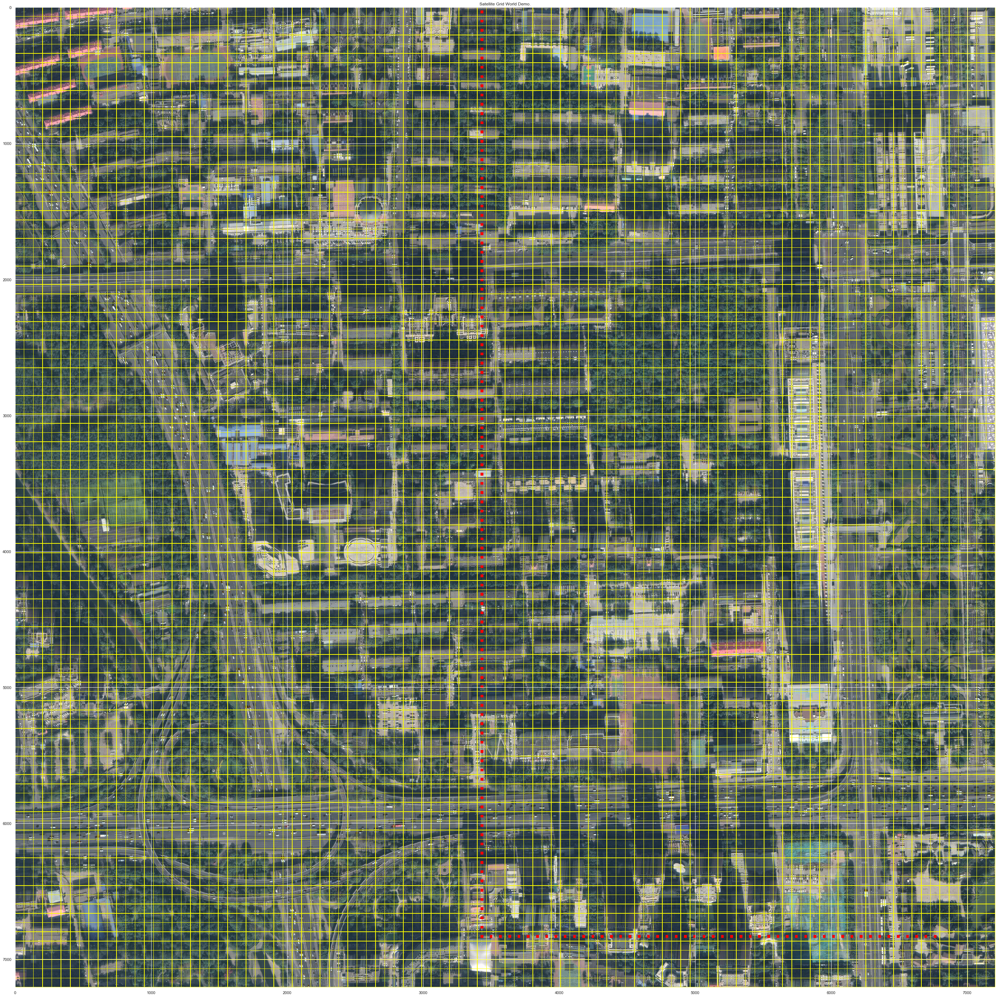

In [12]:
plt.figure(figsize=(50,50))
plt.imshow(sat_grid.permute(1,2,0))
plt.title("Satellite Grid World Demo.")

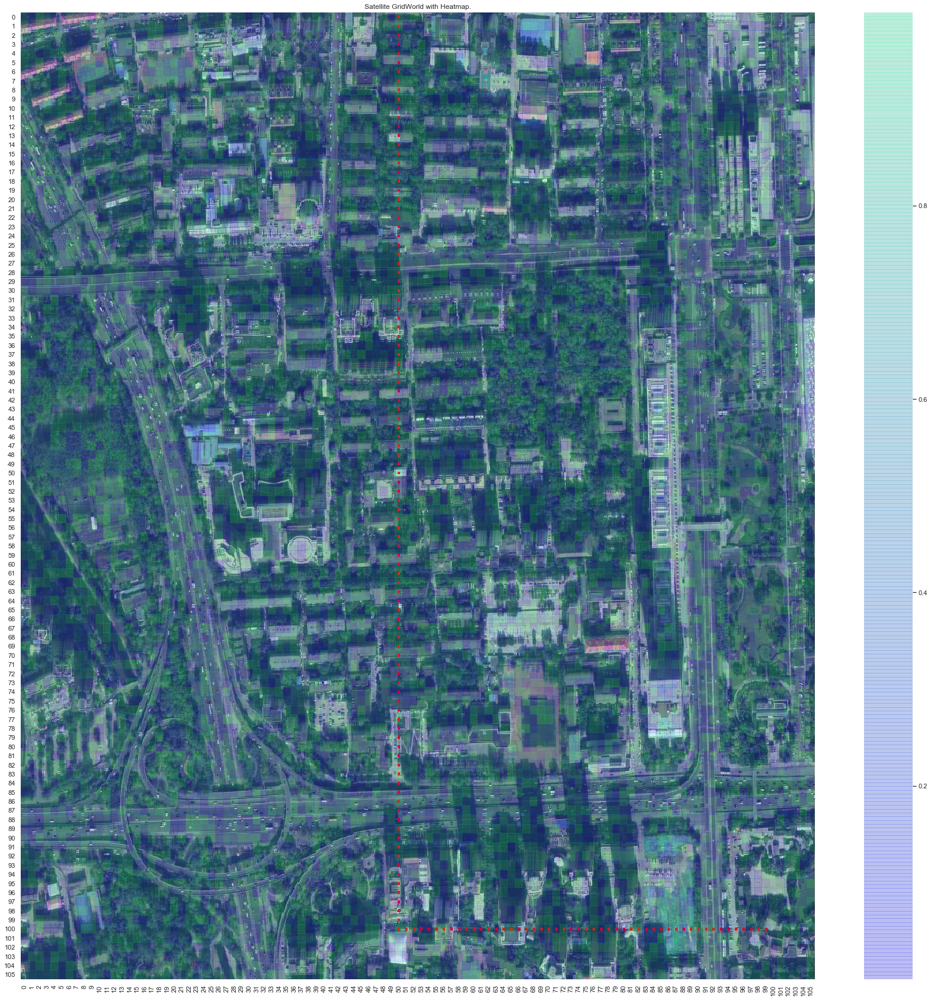

In [15]:
## Heatmap sample
import seaborn as sns; sns.set()

# Adapted from: https://stackoverflow.com/questions/50091591/plotting-seaborn-heatmap-on-top-of-a-background-picture
plt.figure(figsize=(30,30))

sat_grid = satnav_gw.get_feature_grid(border_width=0, border=(1., 1., 0.), 
                                      traj_list=traj_list, traj_colors=traj_colors, dot_size=10)
map_img = sat_grid.permute(1,2,0)

heatmap_data = np.random.rand(satnav_gw.height, satnav_gw.width)
hmax = sns.heatmap(heatmap_data,
            cmap = plt.cm.winter,
            alpha = 0.2, # whole heatmap is translucent
            annot = False,
            zorder = 2,
            )
hmax.imshow(map_img,
          aspect = hmax.get_aspect(),
          extent = hmax.get_xlim() + hmax.get_ylim(),
          zorder = 1) #put the map under the heatmap
plt.title("Satellite GridWorld with Heatmap.")
plt.show()